EDA – Exploration des Données

1. Objectif de l’EDA

L’objectif de l’analyse exploratoire des données est de :

Comprendre la distribution des classes

Identifier le déséquilibre éventuel

Analyser la taille des bounding boxes

Étudier la complexité des annotations

Détecter les anomalies dans les labels

Déterminer les améliorations possibles avant entraînement

1 Importations et chargement des données

In [1]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from pathlib import Path
from collections import Counter

In [9]:
BASE_DIR = Path("../../dataset yolo")
LABELS_DIR = BASE_DIR /"all/labels"

2. Analyse Distribution des Classes

Voici les classes que nous avons 

    0:Hardhat
    1:Mask
    2:NO-Hardhat
    3:NO-Mask
    4:NO-Safety Vest
    5:Person
    6:Safety Cone
    7:Safety Vest
    8:machinery
    9:utility pole
    10:vehicle


In [17]:
def load_class_distribution(labels_path):
    class_counter = Counter()

    for label_file in labels_path.glob("*.txt"):
        with open(label_file, "r") as f:
            lines = f.readlines()

            for line in lines:
                class_id = int(line.split()[0])
                class_counter[class_id] += 1

    return class_counter


class_distribution = load_class_distribution(LABELS_DIR)

print("Distribution des classes :")
print(class_distribution)

Distribution des classes :
Counter({8: 12296, 5: 10577, 6: 9492, 0: 5515, 7: 5021, 4: 4510, 10: 4228, 3: 3735, 2: 3648, 9: 1697, 1: 1118})


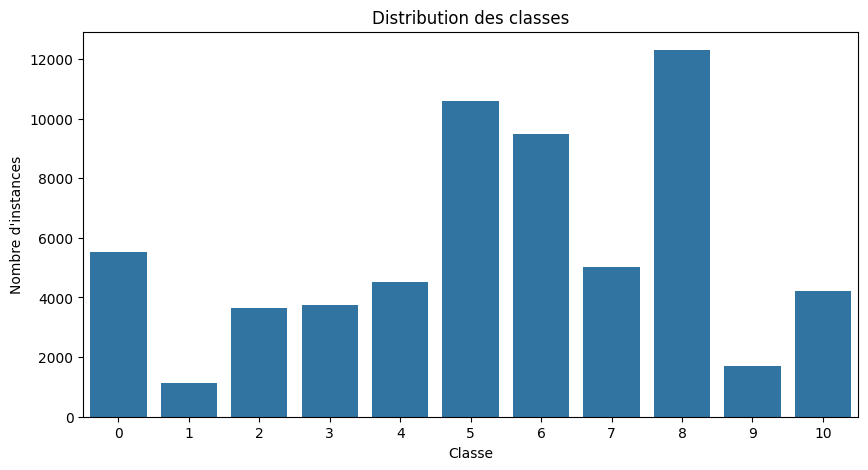

In [19]:
classes = list(class_distribution.keys())
counts = list(class_distribution.values())

plt.figure(figsize=(10,5))
sns.barplot(x=classes, y=counts)
plt.title("Distribution des classes")
plt.xlabel("Classe")
plt.ylabel("Nombre d'instances")
plt.show()

Interprétation

Le jeu de données est déséquilibré : machinery (12 296) est la classe dominante, tandis que mask (1 118) est très rare.
Les équipements de sécurité (casques, gilets) sont bien représentés, mais les infractions correspondantes sont moins nombreuses.
Cela signifie que le modèle détectera mieux les objets fréquents et aura plus de difficulté avec les classes comme mask ou utility pole.

3. Analyse des tailles des Bounding Boxes

Comprendre si tu as beaucoup de petits objets (problème fréquent sur chantier)

In [20]:
#Extraction des tailles bbox
def extract_bbox_sizes(labels_path):
    widths = []
    heights = []

    for label_file in labels_path.glob("*.txt"):
        with open(label_file, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) == 5:
                    _, x, y, w, h = map(float, parts)
                    widths.append(w)
                    heights.append(h)

    return widths, heights


w, h = extract_bbox_sizes(LABELS_DIR)

In [25]:
h

[0.7545783132530121,
 0.38421686746987954,
 0.07951807228915662,
 0.27072289156626506,
 0.07783132530120482,
 0.9686809815950921,
 0.15975460122699386,
 0.031472392638036806,
 0.05104294478527607,
 0.05628834355828221,
 0.02849693251533742,
 0.03257668711656442,
 0.02941717791411043,
 0.025828220858895707,
 0.02361963190184049,
 0.02294478527607362,
 0.03573619631901841,
 0.023466257668711656,
 0.3289112903225806,
 0.06463709677419355,
 0.0939516129032258,
 0.21370967741935484,
 0.03161290322580645,
 0.047903225806451614,
 0.12443548387096774,
 0.2114375,
 0.0671875,
 0.06864583333333334,
 0.04504166666666667,
 0.05410416666666666,
 0.05120833333333333,
 0.042124999999999996,
 0.03741666666666667,
 0.04139583333333333,
 0.035958333333333335,
 0.03377083333333333,
 0.03160416666666667,
 0.02722916666666667,
 0.028333333333333332,
 0.024687499999999998,
 0.026145833333333333,
 0.023979166666666666,
 0.023979166666666666,
 0.021437499999999998,
 0.022520833333333334,
 0.07264583333333333,

In [ ]:
w

([0.4097752808988764,
  0.1047752808988764,
  0.03839887640449438,
  0.05924157303370786,
  0.02047752808988764,
  0.3431496062992126,
  0.09059055118110237,
  0.01248031496062992,
  0.011988188976377953,
  0.0184251968503937,
  0.00889763779527559,
  0.01,
  0.013188976377952756,
  0.011929133858267715,
  0.009015748031496063,
  0.007440944881889763,
  0.011850393700787401,
  0.011614173228346457,
  0.29029829545454544,
  0.011562500000000002,
  0.018125,
  0.05821022727272727,
  0.019048295454545453,
  0.032883522727272727,
  0.05730113636363637,
  0.2799573863636364,
  0.01609375,
  0.017826704545454545,
  0.014360795454545454,
  0.018082386363636363,
  0.016832386363636362,
  0.014360795454545454,
  0.011633522727272727,
  0.007428977272727274,
  0.010397727272727274,
  0.010894886363636364,
  0.009659090909090909,
  0.009659090909090909,
  0.007926136363636364,
  0.007926136363636364,
  0.008167613636363636,
  0.007926136363636364,
  0.005937499999999999,
  0.006193181818181819,
 

Histogramme tailles bbox

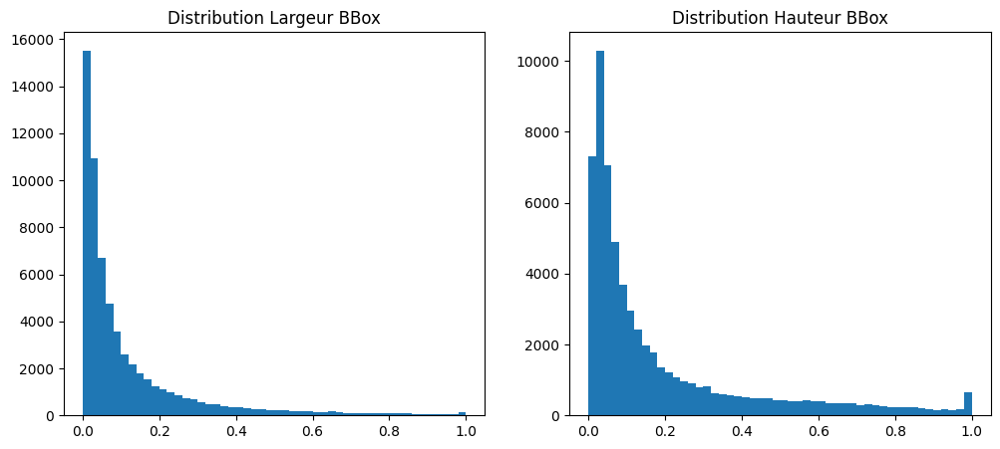

In [21]:
plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
plt.hist(w, bins=50)
plt.title("Distribution Largeur BBox")

plt.subplot(1,2,2)
plt.hist(h, bins=50)
plt.title("Distribution Hauteur BBox")

plt.show()

Largeurs : Distribution assez étalée entre 0 et 1 avec une concentration de valeurs autour de 0-0.2 et 0.3-0.5, indiquant une variété d'objets de différentes largeurs dans votre dataset.

Hauteurs : Forte concentration de valeurs très faibles (proches de 0), ce qui signifie que la majorité de vos boîtes sont très peu hautes (objets allongés horizontalement). Quelques valeurs s'étendent jusqu'à 1, mais elles sont rares.

Conclusion : Le dataset contient principalement des objets en format paysage (larges mais peu hauts), avec quelques objets plus équilibrés.

4. Détection Anomalies Labels

Pour détecter: 

Labels vides

Classes inconnues

Bounding box invalide

In [22]:
def check_label_errors(labels_path):
    errors = []

    for label_file in labels_path.glob("*.txt"):
        with open(label_file, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    errors.append(label_file)

    return errors


errors = check_label_errors(LABELS_DIR)
print("Fichiers avec erreurs :", errors)

Fichiers avec erreurs : []


Pas d'anomalie dans les labels.

5. Analyse Nombre d’Objets par Image

Pour voir exactement combien d'objet en moyenne on a par image . Très important. 

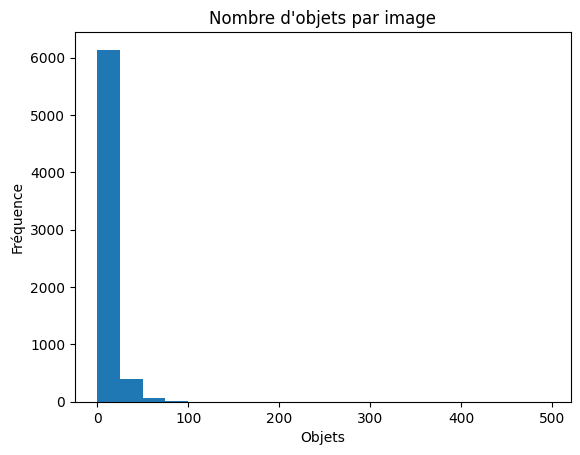

In [23]:
def objects_per_image(labels_path):
    counts = []

    for label_file in labels_path.glob("*.txt"):
        with open(label_file, "r") as f:
            lines = f.readlines()
            counts.append(len(lines))

    return counts


objects_count = objects_per_image(LABELS_DIR)

plt.hist(objects_count, bins=20)
plt.title("Nombre d'objets par image")
plt.xlabel("Objets")
plt.ylabel("Fréquence")
plt.show()

La distribution est extrêmement concentrée vers 0 : la grande majorité des images contiennent très peu d'objets (probablement 0, 1 ou 2). On observe une décroissance exponentielle avec très peu d'images dépassant 50 objets, et quasiment aucune au-delà de 100. Cela indique un dataset avec des scènes faiblement peuplées, typique de la détution d'objets courante (pas d'images surchargées).

### Visualisation des images 

In [28]:
BASE_DIR = Path("../../dataset yolo")
LABELS_DIR = BASE_DIR /"all/labels"
IMAGES_DIR = BASE_DIR /"all/images"

In [26]:
import random
import cv2
import matplotlib.pyplot as plt
from pathlib import Path

Sélection des 20 images aléatoires

In [ ]:
image_files = list(IMAGES_DIR.glob("*.jpg")) + list(IMAGES_DIR.glob("*.png"))

random.seed(42)
sample_images = random.sample(image_files, 20)


[WindowsPath('../../dataset yolo/all/images/istockphoto-1372364176-612x612_jpg.rf.e1782db28e51c3ee0339c884ca8a18ba.jpg'),
 WindowsPath('../../dataset yolo/all/images/000833_jpg.rf.ee1b5f0bd9d5e5784c28fe725babffff.jpg'),
 WindowsPath('../../dataset yolo/all/images/000124_jpg.rf.b67314ef352e36b3924398a83a3c1f19.jpg'),
 WindowsPath('../../dataset yolo/all/images/LINE_ALBUM_2024-3-25_240325_81_jpg.rf.533485b8acb09f13f47913426f5a0d39.jpg'),
 WindowsPath('../../dataset yolo/all/images/002185_jpg.rf.f8534f9feb4580e4b41ef2a0382cf930.jpg'),
 WindowsPath('../../dataset yolo/all/images/001935_jpg.rf.072c4806476bc1825f9b2b38ac6a1319.jpg'),
 WindowsPath('../../dataset yolo/all/images/001754_jpg.rf.338ae0cd4c5a47e4a10d8d3e64b7cfa2.jpg'),
 WindowsPath('../../dataset yolo/all/images/001064_jpg.rf.04f938915cae22aaf515301f0a9cf686.jpg'),
 WindowsPath('../../dataset yolo/all/images/LINE_ALBUM_2024-3-25_240325_42_jpg.rf.850d5b03f349b54358d0707e0974b04b.jpg'),
 WindowsPath('../../dataset yolo/all/images/00

Fonction pour dessiner les bounding boxes

In [31]:
def draw_bboxes(image_path, label_path):
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    h_img, w_img, _ = image.shape

    if label_path.exists():
        with open(label_path, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) == 5:
                    class_id, x, y, w, h = map(float, parts)

                    # Conversion YOLO → pixel
                    x_center = int(x * w_img)
                    y_center = int(y * h_img)
                    width = int(w * w_img)
                    height = int(h * h_img)

                    x_min = int(x_center - width / 2)
                    y_min = int(y_center - height / 2)
                    x_max = int(x_center + width / 2)
                    y_max = int(y_center + height / 2)

                    cv2.rectangle(image, (x_min, y_min), (x_max, y_max),
                                  (0, 255, 0), 2)

    return image

Visualisation AVEC bounding boxes

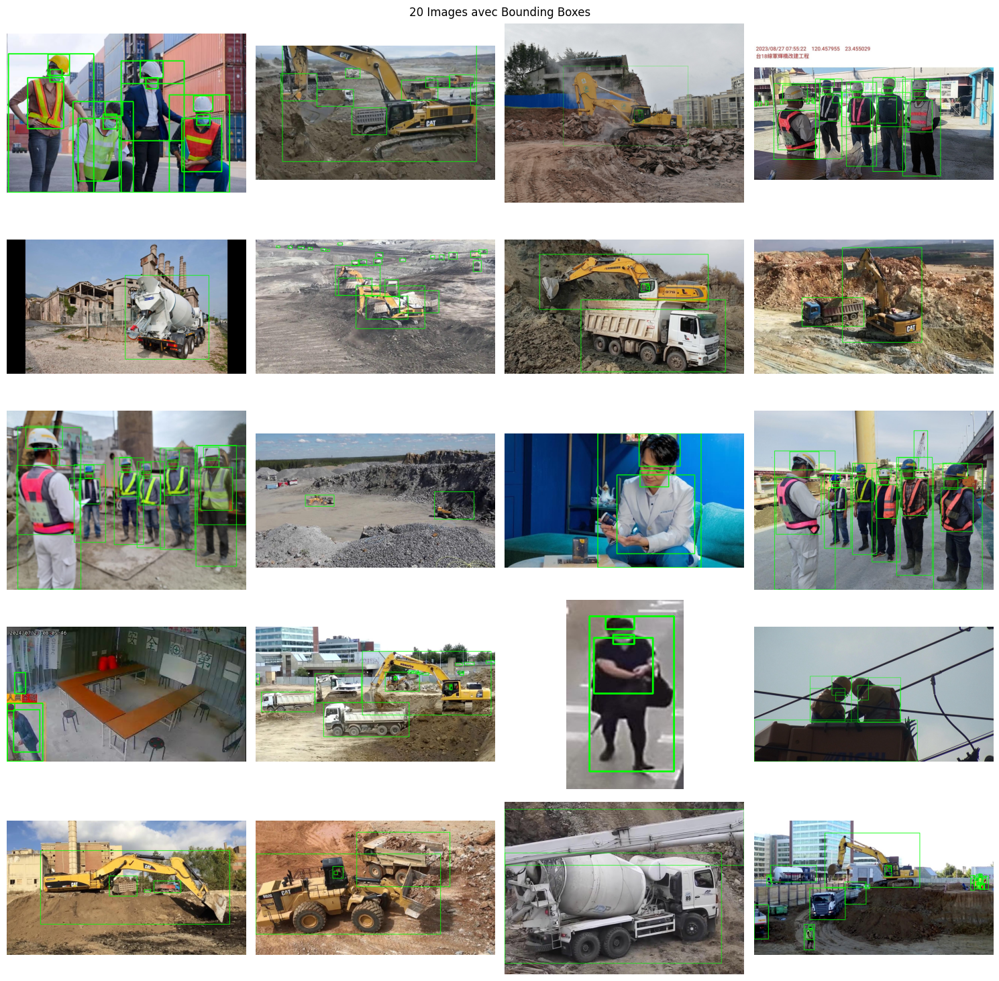

In [32]:
plt.figure(figsize=(15, 15))

for i, img_path in enumerate(sample_images):
    label_path = LABELS_DIR / (img_path.stem + ".txt")

    img_with_boxes = draw_bboxes(img_path, label_path)

    plt.subplot(5, 4, i + 1)
    plt.imshow(img_with_boxes)
    plt.axis("off")

plt.suptitle("20 Images avec Bounding Boxes")
plt.tight_layout()
plt.show()

Visualisation SANS bounding boxes

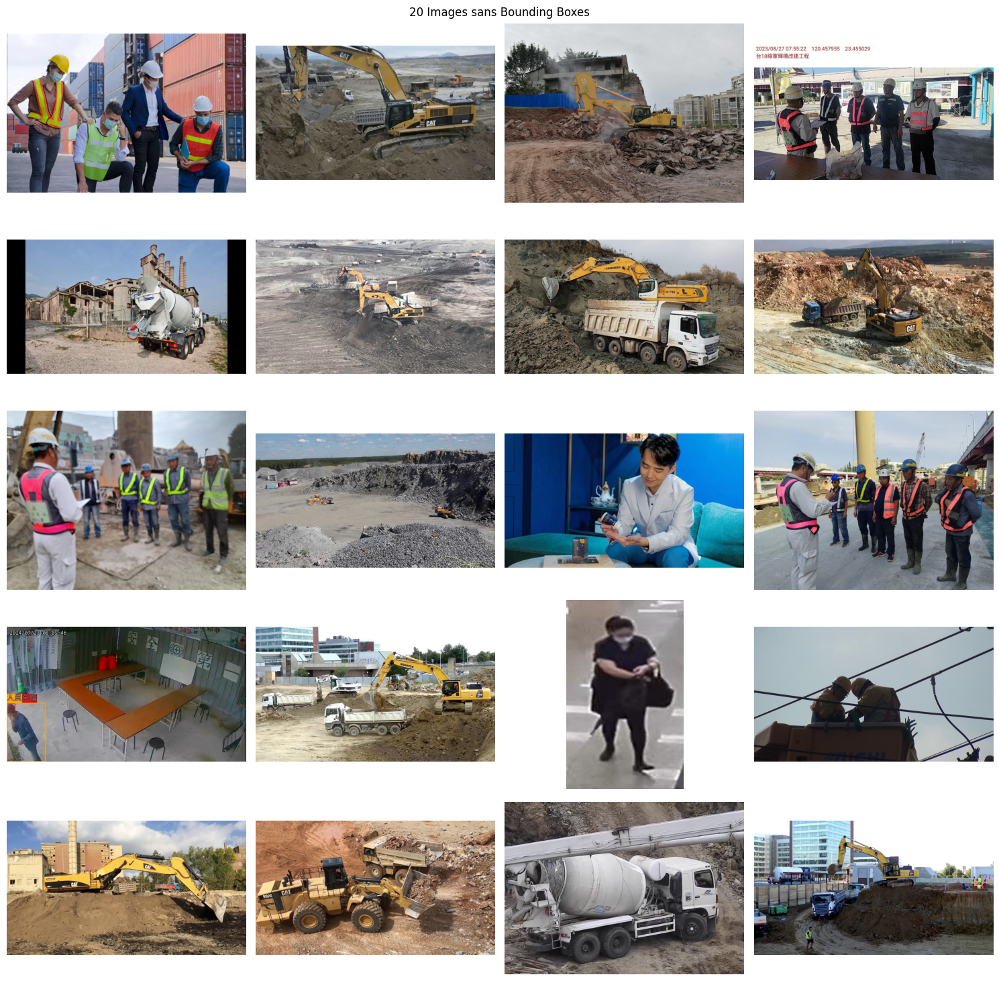

In [33]:
plt.figure(figsize=(15, 15))

for i, img_path in enumerate(sample_images):
    image = cv2.imread(str(img_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.subplot(5, 4, i + 1)
    plt.imshow(image)
    plt.axis("off")

plt.suptitle("20 Images sans Bounding Boxes")
plt.tight_layout()
plt.show()

In [34]:
image_files = list(IMAGES_DIR.glob("*.jpg")) + list(IMAGES_DIR.glob("*.png"))

random.seed(42)
sample_images = random.sample(image_files, 2)

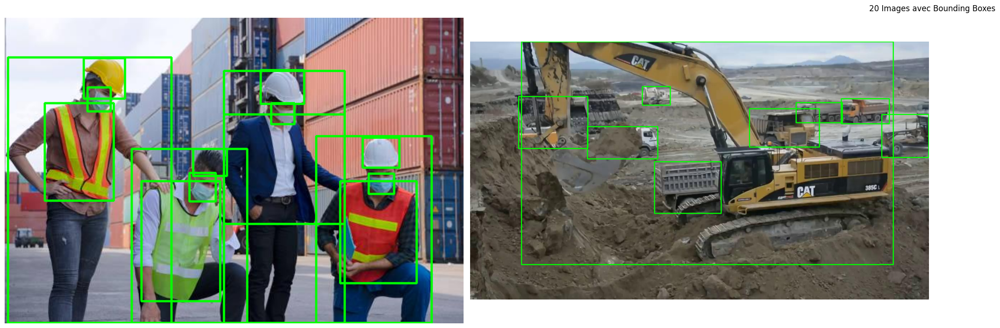

In [36]:
plt.figure(figsize=(40, 40))

for i, img_path in enumerate(sample_images):
    label_path = LABELS_DIR / (img_path.stem + ".txt")

    img_with_boxes = draw_bboxes(img_path, label_path)

    plt.subplot(5, 4, i + 1)
    plt.imshow(img_with_boxes)
    plt.axis("off")

plt.suptitle("20 Images avec Bounding Boxes")
plt.tight_layout()
plt.show()

### Données problématiques

### Détection des images sans labels

In [37]:
from pathlib import Path
import cv2
import matplotlib.pyplot as plt


images_without_labels = []
empty_labels = []

for img_path in IMAGES_DIR.glob("*.*"):
    label_path = LABELS_DIR / (img_path.stem + ".txt")

    if not label_path.exists():
        images_without_labels.append(img_path)
    else:
        # Vérifier si label vide
        if label_path.stat().st_size == 0:
            empty_labels.append(img_path)

print("Images sans fichier label :", len(images_without_labels))
print("Images avec label vide :", len(empty_labels))

Images sans fichier label : 0
Images avec label vide : 138


### Visualiser les images sans labels

In [40]:
def show_images(image_list, title, max_images=12):
    plt.figure(figsize=(85, 90))

    for i, img_path in enumerate(image_list[:max_images]):
        image = cv2.imread(str(img_path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.subplot(3, 4, i + 1)
        plt.imshow(image)
        plt.title(img_path.name)
        plt.axis("off")

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()


show_images(images_without_labels, "Images sans fichier label")
show_images(empty_labels, "Images avec label vide")

<Figure size 8500x9000 with 0 Axes>

In [41]:
total_images = len(list(IMAGES_DIR.glob("*.*")))
negative_images = len(empty_labels)

print("Total images :", total_images)
print("Images négatives :", negative_images)
print("Pourcentage négatif : {:.2f}%".format(100 * negative_images / total_images))

Total images : 6632
Images négatives : 138
Pourcentage négatif : 2.08%


In [42]:
import random

sample_negatives = random.sample(empty_labels, 20)
show_images(sample_negatives, "Échantillon d'images négatives")

Une analyse des images sans annotations a été effectuée afin d’identifier d’éventuelles erreurs d’étiquetage.
Les images sans label ont été examinées visuellement afin de distinguer les véritables exemples négatifs des oublis d’annotation susceptibles d’affecter le recall du modèle.